In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) { return false; }

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
from IPython.core.display import display, HTML, Javascript
display(HTML('<style>.container { width:90% !important; }</style>'))

import lightgbm as lgb
import matplotlib.pyplot as plt
import numpy as np
import pickle
from scipy.sparse import load_npz
import shap
shap.initjs()

def logit(p):
    return np.log(p) - np.log(1 - p)

def inv_logit(l):
    return np.exp(l) / (1 + np.exp(l))

Shapley values, a method originating from game theory, helps quantify the contibution of each feature in a prediction.  The original problem is, in a team that is composed of multiple players with differing skill sets, that results in some collective payoff, what is the fairest way to divide up that payoff among the players?

The Shapley value is the average marginal contribution of a feature value across all possible feature combinations or coalitions.

#### Reading Data and Model

In [3]:
X_train_csr = load_npz('saved/X_train.npz')
print('X_train: {:,} x {}'.format(*X_train_csr.shape))
y_train = np.load('saved/y_train.npy')
print('y_train: {:,}'.format(*y_train.shape))
X_test_csr = load_npz('saved/X_test.npz')
print('X_test: {:,} x {}'.format(*X_test_csr.shape))
y_test = np.load('saved/y_test.npy')
print('y_test: {:,}'.format(*y_test.shape))

X_train = X_train_csr.toarray()
X_test = X_test_csr.toarray()

with open('saved/vocab.pkl', 'rb') as f:
     vocab = pickle.load(f)
print('vocab: {:,}'.format(len(vocab)))

model_gbm = lgb.Booster(model_file='saved/lgbm.txt')

X_train: 58,820 x 991
y_train: 58,820
X_test: 15,124 x 991
y_test: 15,124
vocab: 991


#### Understanding the Base Value

* base value is the expected value of the margin (log odds ratio for binary classification) of the model output

In [4]:
explainer = shap.TreeExplainer(model_gbm, data=X_train)
print('base value (from TreeExplainer):', explainer.expected_value)

base value (from TreeExplainer): -0.35862297664652826


scores: 58,820


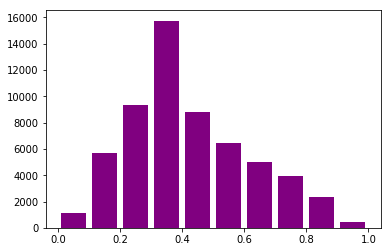

average log odds: -0.35862297664652837


In [5]:
#model scores for binary classification using lightgbm
scores = model_gbm.predict(X_train)
print('scores: {:,}'.format(*scores.shape))

_ = plt.hist(scores, np.array(list(range(0,101,10)))/100, histtype='bar', rwidth=.8, color='purple')
_ = plt.show()

#converting back to log odds
logodds = logit(scores)
print('average log odds: {}'.format(logodds.sum()/scores.shape[0]))

#### Understanding One Shapey Explanation

In [6]:
n = 1000
shap_values = explainer.shap_values(X_train[n,])
shap_values.shape

print('base value as a probability:{0:}'.format(inv_logit(explainer.expected_value)))
print('predicted/output value   prob:{0:},   log odds:{1:}'.format(scores[n],logit(scores[n])))

shap.force_plot(explainer.expected_value, shap_values, X_train[n,], feature_names=vocab)
shap.force_plot(explainer.expected_value, shap_values, X_train[n,], feature_names=vocab, link='logit')

(991,)

base value as a probability:0.41129294528788496
predicted/output value   prob:0.5857335674946541,   log odds:0.34635569960040136


#### Selecting Scores

In [7]:
#top N (cases)
N = 200
if 0:
    ind = np.argsort(scores)[-N:][::-1]

#bottom N (controls)
if 1:
    ind = np.argsort(scores)[:N]

#middle N
if 0:
    m = np.array((scores.shape[0]/2-N/2,scores.shape[0]/2+N/2)).astype(np.uint32)
    ind = np.argsort(scores)[m[0]:m[1]]

Xind = X_train[ind,:]
shap_values = explainer.shap_values(Xind)

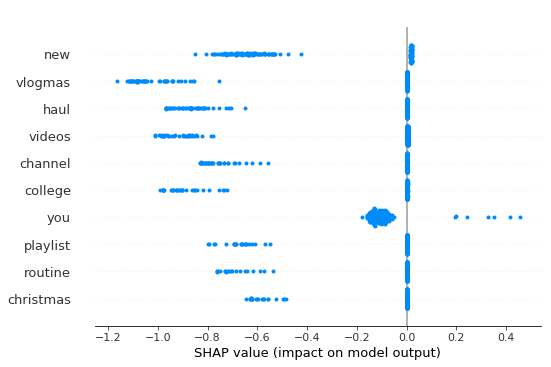

In [8]:
shap.summary_plot(shap_values, feature_names=vocab, max_display=10)

shap.force_plot(explainer.expected_value, shap_values, Xind, feature_names=vocab, link='logit')

In [9]:
for n in range(100,120):
   shap.force_plot(explainer.expected_value, shap_values[n,], Xind[n,], feature_names=vocab, link='logit')

In [10]:
#pain, anxiety, sad, happy, family, christmas
col = [n for n,x in enumerate(vocab) if x=='christmas']
ind1 = np.where(X_train[:,col].ravel())[0]
print('#people:', ind1.shape[0])

ind2 = np.argsort(scores[ind1])[:N][::-1]

Xt = X_train[ind1,:][ind2,:]
shap_values = explainer.shap_values(Xt)

#people: 285


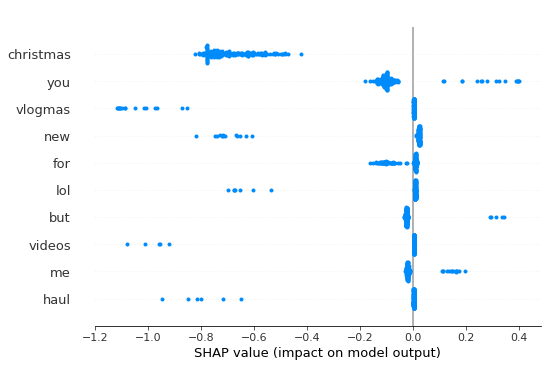

In [11]:
shap.summary_plot(shap_values, feature_names=vocab, max_display=10)

shap.force_plot(explainer.expected_value, shap_values, Xind, feature_names=vocab, link='logit')

In [12]:
for n in range(0,20):
   shap.force_plot(explainer.expected_value, shap_values[n,], Xt[n,], feature_names=vocab, link='logit')